# UBER Pickups 
### WEEK ANALYSIS

In [ ]:
!pip install plotly==4.9.0
!pip install jupyterlab "ipywidgets>=7.5"
!jupyter labextension install jupyterlab-plotly@4.9.0
!jupyter labextension install @jupyter-widgets/jupyterlab-manager plotlywidget@4.9.0
!jupyter labextension list

  Using cached plotly-4.9.0-py2.py3-none-any.whl (12.9 MB)
Processing /home/jovyan/.cache/pip/wheels/c4/a7/48/0a434133f6d56e878ca511c0e6c38326907c0792f67b476e56/retrying-1.3.3-py3-none-any.whl
Building jupyterlab assets (build:prod:minimize)
Building jupyterlab assets (build:prod:minimize)
-

In [9]:
!jupyter lab build

[LabBuildApp] JupyterLab 2.2.8
[LabBuildApp] Building in /opt/conda/share/jupyter/lab
[LabBuildApp] Building jupyterlab assets (build:prod:minimize)


## CLUSTERING

In [1]:
# Importing usefull libraries

import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
import plotly.graph_objects as go
import plotly.express as px

In [2]:
# Importing the pre-cleaned dataset with gps information for week 36

X = pd.read_csv('uber_pickups_week36.csv')
X.head()

,Lat,Lon,dayofweek
0,40.2201,-74.0021,0
1,40.7500,-74.0027,0
2,40.7559,-73.9864,0
3,40.7450,-73.9889,0
4,40.8145,-73.9444,0


In [3]:
sc = StandardScaler()
X_norm = sc.fit_transform(X)

### SELECTING K OPTIMAL CLUSTERS
#### ELBOW METHOD

In [45]:
# Creating a loop that will collect the Within-sum-of-square (wcss) for each value K
wcss =  []
for i in range (1,11): 
    kmeans = KMeans(n_clusters= i, init = "k-means++", random_state = 0)
    kmeans.fit(X_norm)
    wcss.append(kmeans.inertia_)
    print("WCSS for K={} --> {}".format(i, wcss[-1]))

WCSS for K=1 --> 698267.9999999836
WCSS for K=2 --> 527512.485527322
WCSS for K=3 --> 400867.25789159734
WCSS for K=4 --> 334252.5943861225
WCSS for K=5 --> 296117.948223057
WCSS for K=6 --> 265080.27610922436
WCSS for K=7 --> 239668.0188473579
WCSS for K=8 --> 218928.70479065238
WCSS for K=9 --> 198435.0650350454
WCSS for K=10 --> 179152.23434138723


Text(0, 0.5, 'Inertia')

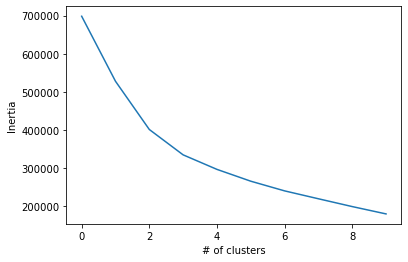

In [46]:
# Visualizing the inertia against the number of clusters

wcss_frame = pd.DataFrame(wcss)
sns.lineplot(x = wcss_frame.index, y = wcss_frame.iloc[: , -1], data = wcss_frame)
plt.xlabel('# of clusters')
plt.ylabel('Inertia')

#### SILHOUETTE METHOD

In [ ]:
# Computing mean silhouette score
sil = []
for i in range (2,6): 
    kmeans = KMeans(n_clusters= i, init = "k-means++", random_state = 0)
    kmeans.fit(X_norm)
    sil.append(silhouette_score(X_norm, kmeans.predict(X_norm)))
    print("Silhouette score for K={} is {}".format(i, sil[-1]))

In [ ]:
# Visualizing the inertia against the number of clusters

sil_frame = pd.DataFrame(sil)
sns.catplot(x = sil_frame.index, y = sil_frame.iloc[: , -1], data = sil_frame, kind = 'bar')
plt.xlabel('# of clusters')
plt.ylabel('Silhouette score')

#### CONCLUSION
Through what we saw thanks to the Elbow and the Silhouette methods, we choose 5 clusters for KMean for the 7 days

### BUILDING CLUSTERS

In [4]:
# Instancing and predicting

kmeans = KMeans(n_clusters = 6, random_state = 0, init = "k-means++")
kmeans.fit(X_norm)
y = kmeans.fit_predict(X_norm)

In [5]:
# Adding the cluster number to the original dataset
X["cluster"] = y

In [6]:
# Recomputing true values for visualization
cluster_centers = sc.inverse_transform(kmeans.cluster_centers_)

### VISUALIZING ON A MAP

In [111]:
fig = px.scatter_mapbox(X, lat = 'Lat', lon = 'Lon', color = "cluster")
fig.show()

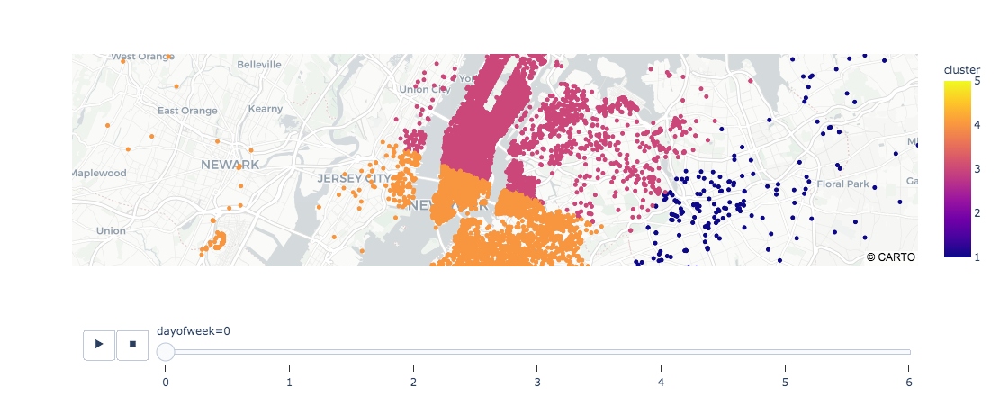

In [7]:
fig = px.scatter_mapbox(X, lat = 'Lat', 
                        lon = 'Lon', 
                        color = "cluster", 
                        zoom = 10, 
                        mapbox_style = "carto-positron",
                        animation_frame = "dayofweek")

fig.show()